In [75]:
import pandas as pd 
from pandas_profiling import ProfileReport
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sb 

In [76]:
df = pd.read_csv("./Data/raw_house_data.csv")

In [77]:
df.head()

,MLS,sold_price,zipcode,longitude,latitude,lot_acres,taxes,year_built,bedrooms,bathrooms,sqrt_ft,garage,kitchen_features,fireplaces,floor_covering,HOA
0,21530491,5300000.0,85637,-110.378200,31.356362,2154.00,5272.00,1941,13,10,10500,0,"Dishwasher, Freezer, Refrigerator, Oven",6,"Mexican Tile, Wood",0
1,21529082,4200000.0,85646,-111.045371,31.594213,1707.00,10422.36,1997,2,2,7300,0,"Dishwasher, Garbage Disposal",5,"Natural Stone, Other",0
2,3054672,4200000.0,85646,-111.040707,31.594844,1707.00,10482.00,1997,2,3,None,None,"Dishwasher, Garbage Disposal, Refrigerator",5,"Natural Stone, Other: Rock",None
3,21919321,4500000.0,85646,-111.035925,31.645878,636.67,8418.58,1930,7,5,9019,4,"Dishwasher, Double Sink, Pantry: Butler, Refri...",4,"Ceramic Tile, Laminate, Wood",None
4,21306357,3411450.0,85750,-110.813768,32.285162,3.21,15393.00,1995,4,6,6396,3,"Dishwasher, Garbage Disposal, Refrigerator, Mi...",5,"Carpet, Concrete",55


In [78]:
df.shape

(5000, 16)

In [79]:
df.describe()

,MLS,sold_price,zipcode,longitude,latitude,lot_acres,taxes,year_built,bedrooms
count,5.000000e+03,5.000000e+03,5000.000000,5000.000000,5000.000000,4990.000000,5.000000e+03,5000.00000,5000.000000
mean,2.127070e+07,7.746262e+05,85723.025600,-110.912107,32.308512,4.661317,9.402828e+03,1992.32800,3.933800
std,2.398508e+06,3.185556e+05,38.061712,0.120629,0.178028,51.685230,1.729385e+05,65.48614,1.245362
min,3.042851e+06,1.690000e+05,85118.000000,-112.520168,31.356362,0.000000,0.000000e+00,0.00000,1.000000
25%,2.140718e+07,5.850000e+05,85718.000000,-110.979260,32.277484,0.580000,4.803605e+03,1987.00000,3.000000
50%,2.161469e+07,6.750000e+05,85737.000000,-110.923420,32.318517,0.990000,6.223760e+03,1999.00000,4.000000
75%,2.180480e+07,8.350000e+05,85749.000000,-110.859078,32.394334,1.757500,8.082830e+03,2006.00000,4.000000
max,2.192856e+07,5.300000e+06,86323.000000,-109.454637,34.927884,2154.000000,1.221508e+07,2019.00000,36.000000


In [80]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   MLS               5000 non-null   int64  
 1   sold_price        5000 non-null   float64
 2   zipcode           5000 non-null   int64  
 3   longitude         5000 non-null   float64
 4   latitude          5000 non-null   float64
 5   lot_acres         4990 non-null   float64
 6   taxes             5000 non-null   float64
 7   year_built        5000 non-null   int64  
 8   bedrooms          5000 non-null   int64  
 9   bathrooms         5000 non-null   object 
 10  sqrt_ft           5000 non-null   object 
 11  garage            5000 non-null   object 
 12  kitchen_features  5000 non-null   object 
 13  fireplaces        5000 non-null   object 
 14  floor_covering    5000 non-null   object 
 15  HOA               5000 non-null   object 
dtypes: float64(5), int64(4), object(7)
memory 

In [81]:
df["kitchen_features"] = df["kitchen_features"].astype("category")

In [82]:
df["floor_covering"] = df["floor_covering"].astype("category")

kitchen_features and floor_covering could be encoded with TF-IDF, word2vec, or fasttext

# Imputation

In [83]:
len(df[df["lot_acres"]==0]) / len(df)

0.007

In [84]:
len(df[df["taxes"]==0]) / len(df)

0.0044

In [85]:
len(df[df["year_built"]==0]) / len(df)

0.001

In [86]:
for i in df.columns:
    print(i)
    print(df[df[i]=="None"].count()/len(df))

MLS
MLS                 0.0
sold_price          0.0
zipcode             0.0
longitude           0.0
latitude            0.0
lot_acres           0.0
taxes               0.0
year_built          0.0
bedrooms            0.0
bathrooms           0.0
sqrt_ft             0.0
garage              0.0
kitchen_features    0.0
fireplaces          0.0
floor_covering      0.0
HOA                 0.0
dtype: float64
sold_price
MLS                 0.0
sold_price          0.0
zipcode             0.0
longitude           0.0
latitude            0.0
lot_acres           0.0
taxes               0.0
year_built          0.0
bedrooms            0.0
bathrooms           0.0
sqrt_ft             0.0
garage              0.0
kitchen_features    0.0
fireplaces          0.0
floor_covering      0.0
HOA                 0.0
dtype: float64
zipcode
MLS                 0.0
sold_price          0.0
zipcode             0.0
longitude           0.0
latitude            0.0
lot_acres           0.0
taxes               0.0
year_built 

In [87]:
for i in df.columns:
    print(i)
    print(df[df[i] == 0].count()/len(df))
#lot_acres, taxes, year_built

MLS
MLS                 0.0
sold_price          0.0
zipcode             0.0
longitude           0.0
latitude            0.0
lot_acres           0.0
taxes               0.0
year_built          0.0
bedrooms            0.0
bathrooms           0.0
sqrt_ft             0.0
garage              0.0
kitchen_features    0.0
fireplaces          0.0
floor_covering      0.0
HOA                 0.0
dtype: float64
sold_price
MLS                 0.0
sold_price          0.0
zipcode             0.0
longitude           0.0
latitude            0.0
lot_acres           0.0
taxes               0.0
year_built          0.0
bedrooms            0.0
bathrooms           0.0
sqrt_ft             0.0
garage              0.0
kitchen_features    0.0
fireplaces          0.0
floor_covering      0.0
HOA                 0.0
dtype: float64
zipcode
MLS                 0.0
sold_price          0.0
zipcode             0.0
longitude           0.0
latitude            0.0
lot_acres           0.0
taxes               0.0
year_built 

In [88]:
df['HOA'].replace('None', 0, inplace=True)

In [89]:
df['bathrooms'].replace('None', 0, inplace=True)

In [90]:
df['garage'].replace('None', 0, inplace=True)

In [91]:
df["sqrt_ft"].replace('None', 0, inplace=True)

In [92]:
df["sqrt_ft"] = df["sqrt_ft"].astype('float')

In [93]:
df["sqrt_ft"] = df.groupby(['bedrooms']).transform(lambda x: x.replace(0, x.mean()))['sqrt_ft']

In [94]:
df["year_built"].value_counts()

2006    247
2007    236
2002    235
2005    230
2004    202
       ... 
1907      1
1921      1
1910      1
1914      1
1927      1
Name: year_built, Length: 112, dtype: int64

In [95]:
df["year_built"].replace(0, 2006, inplace=True)

In [96]:
df["taxes"] = df.groupby(['bedrooms']).transform(lambda x: x.replace(0, x.mean()))['taxes']

In [97]:
df["lot_acres"] = df.groupby(['bedrooms']).transform(lambda x: x.replace(0, x.mean()))['lot_acres']

In [98]:
df["bathrooms"] = df["bathrooms"].astype('float')

In [99]:
df["garage"] = df["garage"].astype('float')

In [100]:
df["HOA"] = df['HOA'].str.replace(',', '', regex=False)
df["HOA"] = df["HOA"].astype('float')

In [127]:
df["kitchen_features"].value_counts()

Dishwasher, Garbage Disposal, Refrigerator, Microwave, Oven                                                                                       1718
Dishwasher, Garbage Disposal, Microwave, Oven                                                                                                      270
Compactor, Dishwasher, Garbage Disposal, Refrigerator, Microwave, Oven                                                                             189
Dishwasher, Garbage Disposal, Refrigerator, Oven                                                                                                   181
Dishwasher, Freezer, Garbage Disposal, Refrigerator, Microwave, Oven                                                                               127
                                                                                                                                                  ... 
Dishwasher, Double Sink, Garbage Disposal, Refrigerator, Appliance Color: Stainless, Counterto

In [126]:
df["floor_covering"].value_counts()

Carpet, Ceramic Tile                        1234
Carpet, Natural Stone                        579
Carpet, Ceramic Tile, Wood                   258
Ceramic Tile                                 247
Concrete                                     242
                                            ... 
Carpet, Other: brick                           1
Carpet, Other: Travertine Tile                 1
Carpet, Other: Travertine & slate              1
Natural Stone, Other: Travertine & Slate       1
Wood, Other: porcelain tile                    1
Name: floor_covering, Length: 311, dtype: int64

# Outlier Detection

In [140]:
def outliers(df):
    for k, v in df.items():
        q1 = v.quantile(0.25)
        q3 = v.quantile(0.75)
        iqr = q3 - q1
        v_col = v[(v <= q1 - 1.5 * iqr) | (v >= q3 + 1.5 * iqr)]
        percent = v_col.shape[0] * 100.0 / df.shape[0]
        print("Column %s outliers = %.2f%%" % (k, percent))
outliers(df[["sold_price", "lot_acres", "taxes", "sqrt_ft", "HOA"]])

Column sold_price outliers = 4.03%
Column lot_acres outliers = 5.36%
Column taxes outliers = 6.41%
Column sqrt_ft outliers = 0.43%
Column HOA outliers = 0.00%


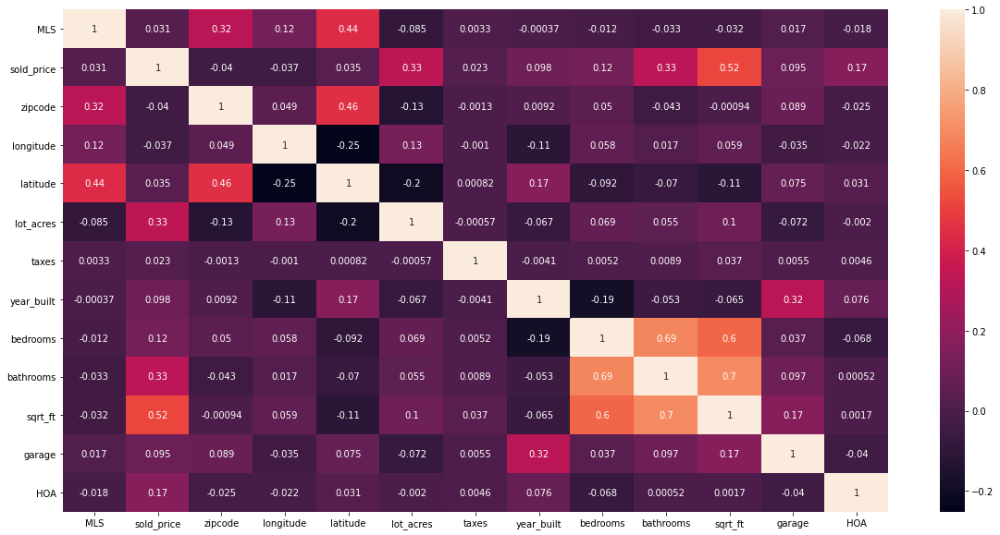

In [104]:
plt.figure(figsize=(20, 10))
sb.heatmap(df.corr(),  annot=True);

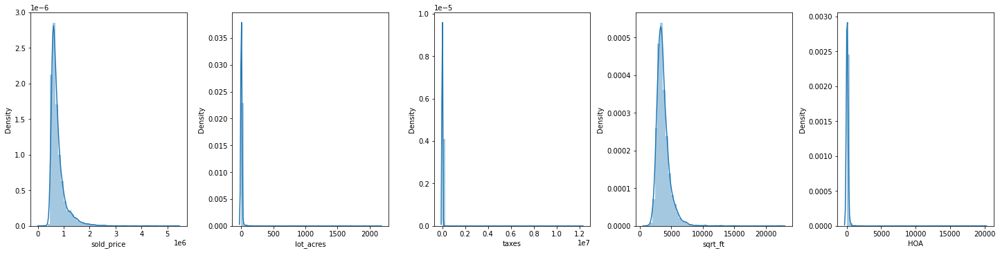

In [105]:
fig, axs = plt.subplots(ncols=5, nrows=1, figsize=(20, 5))
index = 0
axs = axs.flatten()
for k,v in df[["sold_price", "lot_acres", "taxes", "sqrt_ft", "HOA"]].items():
        sb.distplot(v, ax=axs[index])
        index += 1
plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=5.0)

In [106]:
df["sold_price"] = np.log1p(df["sold_price"])

In [107]:
df["lot_acres"] = np.log1p(df["lot_acres"])

In [108]:
df["taxes"] = np.log1p(df["taxes"])

In [109]:
df["sqrt_ft"] = np.log1p(df["sqrt_ft"])

In [110]:
df["HOA"] = np.log1p(df["HOA"])

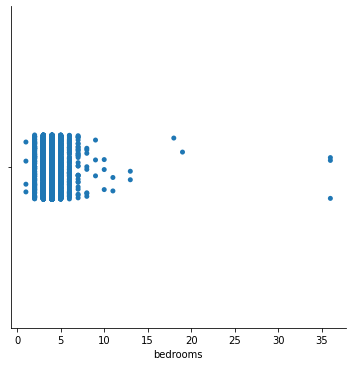

In [111]:
sb.catplot(x="bedrooms", data=df);["sold_price", "lot_acres", "taxes", "sqrt_ft", "HOA"]

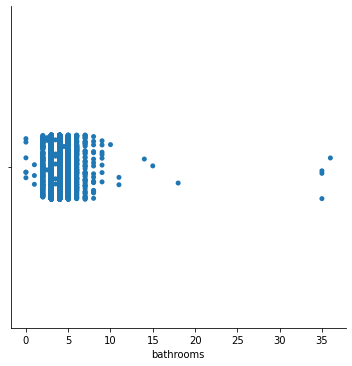

In [112]:
sb.catplot(x="bathrooms", data=df);

In [113]:
df = df[df["bedrooms"] < 30]

In [114]:
df = df[df["bathrooms"] < 30]

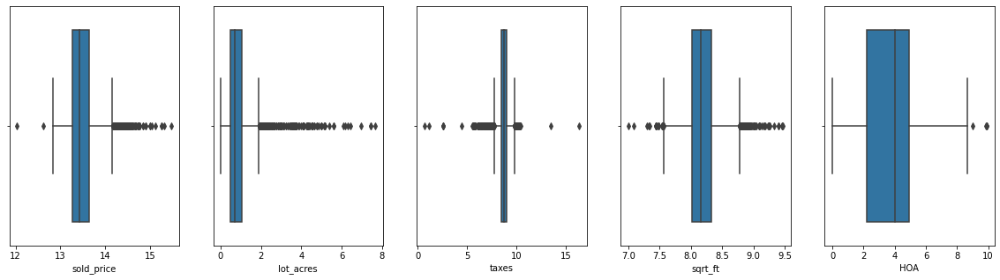

In [115]:
fig, axs = plt.subplots(ncols=5, nrows=1, figsize=(20, 5))
index = 0
axs = axs.flatten()
for k,v in df[["sold_price", "lot_acres", "taxes", "sqrt_ft", "HOA"]].items():
    sb.boxplot(x=k, data=df, ax=axs[index])
    plt.xlabel(k)
    index += 1

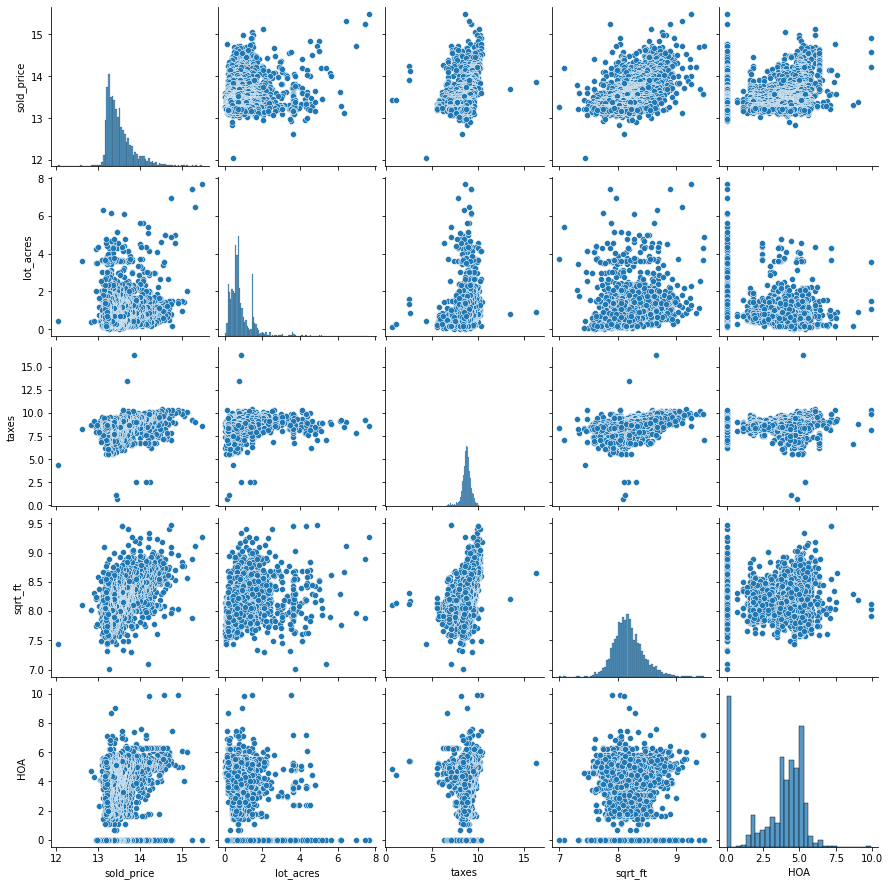

In [116]:
sb.pairplot(data = df[["sold_price", "lot_acres", "taxes", "sqrt_ft", "HOA"]]);

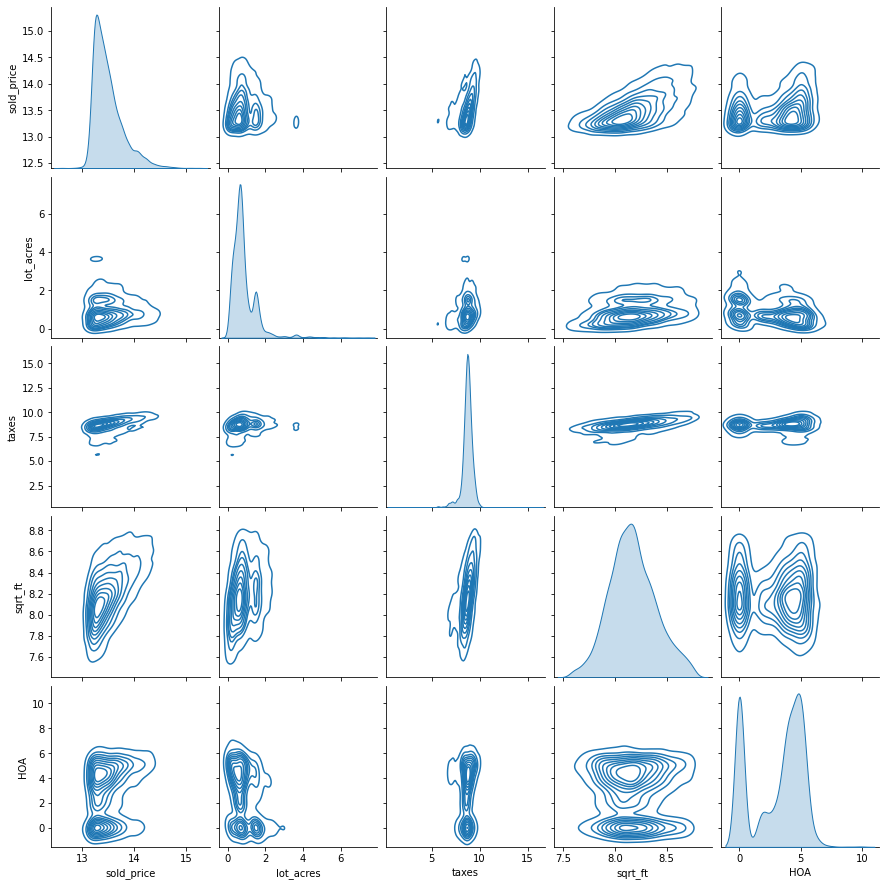

In [139]:
sb.pairplot(data = df[["sold_price", "lot_acres", "taxes", "sqrt_ft", "HOA"]], kind="kde");

In [118]:
profile = ProfileReport(df, title="Pandas Profiling Report")
profile

Render HTML: 100%|██████████| 1/1 [00:05<00:00,  5.81s/it]


In [128]:
# May want to drop MLS, as it is some kind of ID

In [119]:
df[df["HOA"].isna() == True].count()

MLS                 559
sold_price          559
zipcode             559
longitude           559
latitude            559
lot_acres           556
taxes               559
year_built          559
bedrooms            559
bathrooms           559
sqrt_ft             559
garage              559
kitchen_features    559
fireplaces          559
floor_covering      559
HOA                   0
dtype: int64

In [120]:
df["HOA"] = df["HOA"].fillna(0)

In [121]:
df["fireplaces"] = df["fireplaces"].replace(' ', 0)

In [122]:
df["fireplaces"] = df["fireplaces"].astype("int")

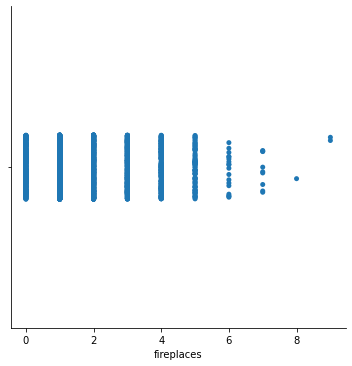

In [123]:
sb.catplot(x="fireplaces", data=df);

In [124]:
df = df[df["fireplaces"] < 8]

In [125]:
outliers(df[["sold_price", "lot_acres", "taxes", "sqrt_ft", "HOA"]])

Column sold_price outliers = 4.47%
Column lot_acres outliers = 5.41%
Column taxes outliers = 6.91%
Column sqrt_ft outliers = 2.54%
Column HOA outliers = 0.00%


In [134]:
q1 = df["sqrt_ft"].quantile(0.25)
q3 = df["sqrt_ft"].quantile(0.75)
iqr = q3 - q1
df = df[df["sqrt_ft"] >= q1 - 1.5 * iqr]
df = df[df["sqrt_ft"] <= q3 + 1.5 * iqr]

In [135]:
outliers(df[["sold_price", "lot_acres", "taxes", "sqrt_ft", "HOA"]])

Column sold_price outliers = 4.03%
Column lot_acres outliers = 5.36%
Column taxes outliers = 6.41%
Column sqrt_ft outliers = 0.43%
Column HOA outliers = 0.00%


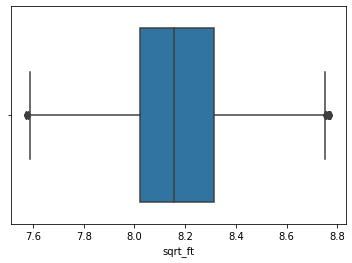

In [137]:
sb.boxplot(x="sqrt_ft", data=df);